In [6]:
import os
os.environ["CUDA_DEVICE_ORDER"] = "PCI_BUS_ID"
os.environ['CUDA_VISIBLE_DEVICES'] = ''
import tensorflow as tf
from tensorflow import keras
import cv2
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from sklearn.preprocessing import LabelBinarizer
import shutil
import json
import numpy as np
from sklearn.model_selection import train_test_split
from skimage.filters import unsharp_mask
from sklearn.metrics import accuracy_score
from tensorflow.keras.layers import Input, GlobalAveragePooling2D, Dense, Dropout
from tensorflow.keras.regularizers import l2
from tensorflow.keras import layers
from tensorflow.keras.applications.resnet50 import preprocess_input
from tensorflow.python.keras import Sequential, Model
from tensorflow.python.keras.optimizers import Adam
from skimage.filters import unsharp_mask
from tensorflow.keras.preprocessing import image
from scipy.ndimage.filters import gaussian_filter, gaussian_laplace
import importlib
                 
from dataset.generate_dataset import GenerateDataset
from dataset.ImageDatasetGenerator import ImageDatasetGenerator
from layers.PreprocessImage import PreprocessImage
from layers.UnsharpMaskLog import UnsharpMaskLoG
from layers.UnsharpMask import UnsharpMask
from layers.UnsharpMaskFixedLambda import UnsharpMaskFixedLambda
from optimizers.LearningRateMultiplier import LearningRateMultiplier
import json

In [7]:
from tensorflow.keras import backend as K
import tensorflow as tf

In [4]:
import torch
import math

def log2d(k, sigma, cuda=False):
    if cuda:
        ax = torch.round(torch.linspace(-math.floor(k/2), math.floor(k/2), k), out=torch.FloatTensor());
        ax = ax.cuda()
    else:
        ax = torch.round(torch.linspace(-math.floor(k/2), math.floor(k/2), k), out=torch.FloatTensor());
    y = ax.view(-1, 1).repeat(1, ax.size(0))
    x = ax.view(1, -1).repeat(ax.size(0), 1)
    x2 = torch.pow(x, 2)
    y2 = torch.pow(y, 2)
    s2 = torch.pow(torch.FloatTensor([sigma]), 2)
    s4 = torch.pow(torch.FloatTensor([sigma]),4)
    hg = (-(x2 + y2)/(2.*s2)).exp()
    kernel_t = hg*(1.0 - (x2 + y2 / 2*s2)) * (1.0 / s4 * hg.sum())
    if cuda:
        kernel = kernel_t - kernel_t.sum() / torch.pow(torch.FloatTensor([k]).cuda(),2)
    else:
        kernel = kernel_t - kernel_t.sum() / torch.pow(torch.FloatTensor([k]),2)
    return kernel
log2d(5, 1)

tensor([[ 0.0234, -0.4245, -0.2466, -0.4245,  0.0234],
        [-1.1840, -0.5464,  2.4591, -0.5464, -1.1840],
        [-1.9163,  0.5883,  6.7572,  0.5883, -1.9163],
        [-1.1840, -0.5464,  2.4591, -0.5464, -1.1840],
        [ 0.0234, -0.4245, -0.2466, -0.4245,  0.0234]])

In [115]:
def LoG_np_new(sigma, kernel_size):
    m, n = [(ss - 1.) / 2. for ss in kernel_size]
    y, x = np.ogrid[-m:m + 1, -n:n + 1]
    x2 = np.power(x, 2)
    y2 = np.power(y, 2)
    s2 = np.power(sigma, 2)
    s4 = np.power(sigma, 4)
    hg = np.exp(-(x2 + y2) / (2. * s2))
    kernel_t = hg * (1 - ((x2 + y2) / 2 * s2)) * (1.0 / s4 * hg.sum())
    kernel = kernel_t - kernel_t.sum() / np.power(kernel_size[0], 2)
    return kernel
LoG_np_new(1.667, (5, 5))

array([[-1.16030473, -1.19606996, -0.85262141, -1.19606996, -1.16030473],
       [-1.19606996,  0.82930174,  2.40471149,  0.82930174, -1.19606996],
       [-0.85262141,  2.40471149,  4.68421136,  2.40471149, -0.85262141],
       [-1.19606996,  0.82930174,  2.40471149,  0.82930174, -1.19606996],
       [-1.16030473, -1.19606996, -0.85262141, -1.19606996, -1.16030473]])

In [117]:
def LoG_np_mathlab(sigma, kernel_size):
    m, n = [(ss - 1.) / 2. for ss in kernel_size]
    y, x = np.ogrid[-m:m + 1, -n:n + 1]
    x2 = np.power(x, 2)
    y2 = np.power(y, 2)
    s2 = np.power(sigma, 2)
    s6 = np.power(sigma, 6)
    hg = np.exp(-1 * ((x2+y2) / 2 * s2))
    uno = ((x2 + y2) - 2 * s2)
    h =  uno * hg
    h = h / (2 * np.pi * s6 * hg.sum())
    return h
LoG_np_mathlab(2, (5, 5))

array([[ 0.00000000e+00, -2.09552165e-07, -2.06452360e-06,
        -2.09552165e-07,  0.00000000e+00],
       [-2.09552165e-07, -1.69078754e-04, -1.45755446e-03,
        -1.69078754e-04, -2.09552165e-07],
       [-2.06452360e-06, -1.45755446e-03, -1.23085162e-02,
        -1.45755446e-03, -2.06452360e-06],
       [-2.09552165e-07, -1.69078754e-04, -1.45755446e-03,
        -1.69078754e-04, -2.09552165e-07],
       [ 0.00000000e+00, -2.09552165e-07, -2.06452360e-06,
        -2.09552165e-07,  0.00000000e+00]])

In [118]:
img = image_generator_maderas[0][0][0]
img.shape

(224, 224, 3)

In [93]:
kernel_log = LoG_np_new(1.667, (5, 5))
kernel_log

array([[ 4.81260773e+14,  6.60732295e+14,  6.28749070e+14,
         6.60732295e+14,  4.81260773e+14],
       [ 2.92655540e+14, -3.39217063e+14, -8.38223251e+14,
        -3.39217063e+14,  2.92655540e+14],
       [ 4.12341827e+13, -1.09021373e+15, -1.86481873e+15,
        -1.09021373e+15,  4.12341827e+13],
       [ 2.92655540e+14, -3.39217063e+14, -8.38223251e+14,
        -3.39217063e+14,  2.92655540e+14],
       [ 4.81260773e+14,  6.60732295e+14,  6.28749070e+14,
         6.60732295e+14,  4.81260773e+14]])

In [119]:
kernel_log = LoG_np_new(1.667, (5, 5))
output_img = cv2.filter2D(np.float32(img), -1, kernel_log, borderType=cv2.BORDER_CONSTANT)
output_img[0][0]

array([1150.6454, 1112.5667, 1284.4191], dtype=float32)

In [ ]:
cv2.resize(x, dim_image)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


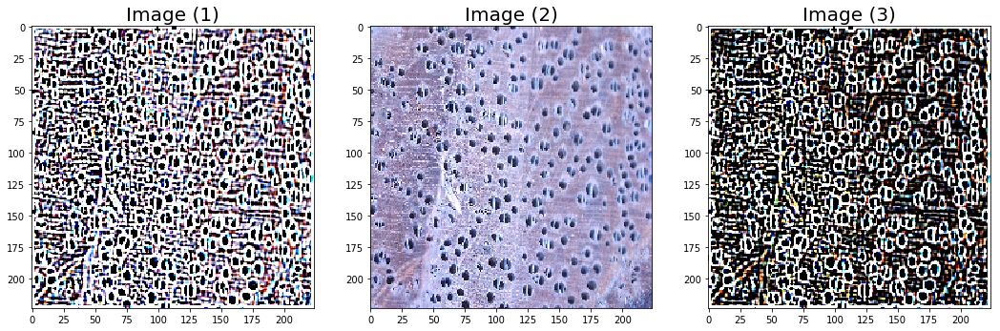

In [121]:
show_images([(1 * output_img + img).astype(int), img, output_img.astype(int)], cols=1)

In [39]:
def gaussian_kernel_cv2(kernel_size, sigma):
    kernel = cv2.getGaussianKernel(kernel_size, sigma)
    kernel = np.dot(kernel, kernel.transpose())
    return kernel

In [52]:
kernel = gaussian_kernel_cv2(5, 1.667)
#Obtener matrix (5, 5) kernel

blurred_kernel = cv2.filter2D(np.float32(img), -1, kernel, borderType=cv2.BORDER_CONSTANT)

In [53]:
blurred = cv2.GaussianBlur(np.float32(img), (5, 5), 1.667, borderType=cv2.BORDER_CONSTANT)

In [69]:
np.testing.assert_allclose(blurred_kernel, blurred, verbose=True, rtol=1e-6)

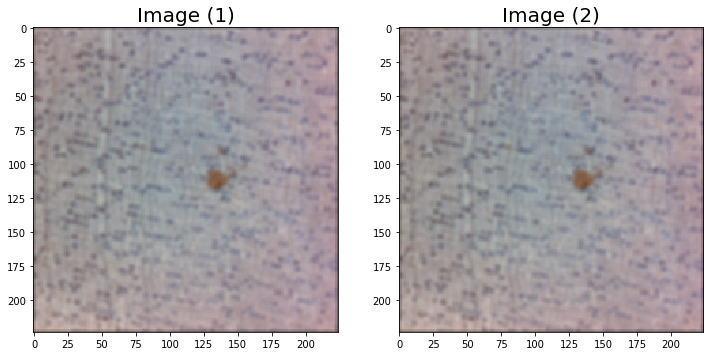

In [67]:
show_images([blurred_kernel.astype(int), blurred.astype(int)], cols=1)

In [6]:
blurred = cv2.GaussianBlur(np.float32(img), (5, 5), 1, borderType=cv2.BORDER_CONSTANT)
blurred[0][0]

NameError: name 'img' is not defined

In [515]:
laplacian_output = cv2.Laplacian(np.float32(blurred), -1, ksize=5, borderType=cv2.BORDER_CONSTANT)
laplacian_output[0][0]

array([-1283.084 , -1216.9784, -1188.9272], dtype=float32)

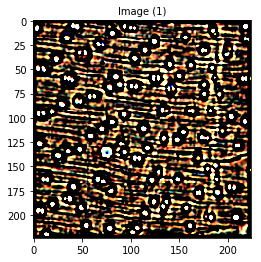

In [516]:
show_images([np.clip(laplacian_output, 0, 255).astype(int)], cols=1)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


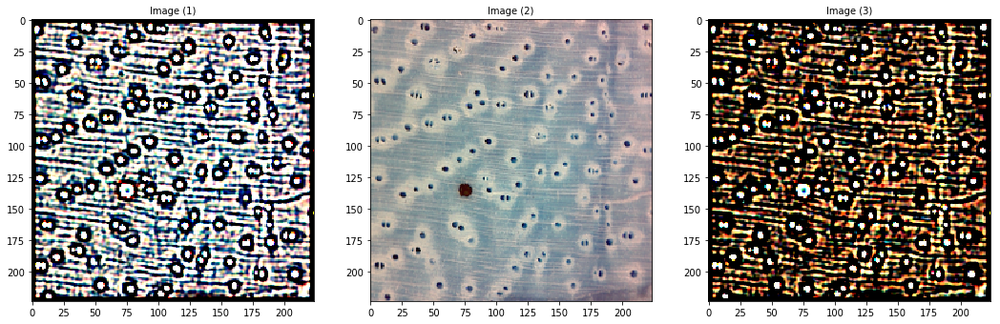

In [517]:
show_images([(laplacian_output + img).astype(int), img, np.clip(laplacian_output, 0, 255).astype(int)], cols=1)

In [4]:
def get_lambda_give_x(input_layer):

    # convolutional block 1
    conv1 = layers.Conv2D(32, kernel_size=(5, 5), activation="relu", name="conv_1")(input_layer)
    batch1 = layers.BatchNormalization(name="batch_norm_1")(conv1)
    pool1 = layers.MaxPooling2D(pool_size=(2, 2), name="pool_1")(batch1)

    # fully connected layers
    gap1 = layers.GlobalAveragePooling2D(name="gap")(pool1)
    dense1 = layers.Dense(256, name='dense1')(gap1)
    output = layers.Dense(1, activation='linear')(dense1)

    return output

def get_unsharp_log_model_fixedLambda(input_shape, kernel_size, sigma, amount):
    
    input_layer = Input(shape=input_shape)
    
    lambda_given_x = get_lambda_give_x(input_layer)
    
    x = UnsharpMaskFixedLambda(kernel_size=(kernel_size,kernel_size),
                            found_sigma=False,
                            sigma=sigma,
                            amount=amount)([lambda_given_x, input_layer])

    my_seq = Model(input_layer, x)


    my_seq.compile(optimizer=Adam(lr=1e-6),
                          loss='mean_squared_error', metrics=['mse'])

    my_seq.summary()
    
    return my_seq

def get_unsharp_log_model(input_shape, kernel_size, sigma, amount):
    
    input_layer = Input(shape=input_shape)
    
    x = UnsharpMaskLoG(kernel_size=(kernel_size,kernel_size),
                            found_sigma=False,
                            sigma=sigma,
                            amount=amount)(input_layer)

    my_seq = Model(input_layer, x)


    my_seq.compile(optimizer=Adam(lr=1e-6),
                          loss='mean_squared_error', metrics=['mse'])

    my_seq.summary()
    
    return my_seq

def get_unsharp_g_model(input_shape, kernel_size, sigma, amount):
    
    input_layer = Input(shape=input_shape)
    
    x = UnsharpMask(kernel_size=(kernel_size,kernel_size),
                            found_sigma=False,
                            sigma=sigma,
                            amount=amount)(input_layer)

    my_seq = Model(input_layer, x)


    my_seq.compile(optimizer=Adam(lr=1e-6),
                          loss='mean_squared_error', metrics=['mse'])

    my_seq.summary()
    
    return my_seq

In [5]:
def apply_unsharp_mask_gaussian(images, kernel_size, sigma, amount):
    unsharp_images = []
    for image in images:
        blurred = cv2.GaussianBlur(np.float32(image), (kernel_size, kernel_size), sigma, borderType=cv2.BORDER_CONSTANT)
        D = (image - blurred)
        image_unsharp = cv2.addWeighted(np.float32(image), 1, np.float32(D), amount, 0)
        unsharp_images.append(image_unsharp)
    return unsharp_images

def apply_unsharp_mask_log(images, kernel_size, sigma, amount):
    unsharp_images = []
    for image in images:
        blurred = cv2.GaussianBlur(np.float32(image), (kernel_size, kernel_size), sigma, borderType=cv2.BORDER_CONSTANT)
        laplacian = cv2.Laplacian(np.float32(blurred), -1, ksize=kernel_size, borderType=cv2.BORDER_CONSTANT)
        laplacian / laplacian.max()
        image_unsharp = image - amount * laplacian
        unsharp_images.append(image_unsharp)
    return unsharp_images

def show_images_from_generator(image_generator, n_images=5):
    total_batches = len(image_generator)
    batch_number = np.random.choice(total_batches, 1)[0]
    batch_data = image_generator[batch_number][0]
    top_batch = list(batch_data[:n_images])
    top_batch = apply_unsharp_mask(top_batch)
    show_images(top_batch, cols=1)

In [6]:
def show_batch(X_train, y_train):
    
    kernel_size = 5
    
    sigma = 1.667
    
    amount = 0.58392626

    input_shape = (224, 224, 3)

    n_images = X_train.shape[0]

    unshar_g_model = get_unsharp_g_model(input_shape, kernel_size, sigma, amount)
    
    unshar_log_model = get_unsharp_log_model(input_shape, kernel_size, sigma, amount)
    
    unshar_g_model_fixed_lambda = get_unsharp_log_model_fixedLambda(input_shape, kernel_size, sigma, amount)
    
    unsharp_g_predictions = unshar_g_model.predict(X_train)
    unsharp_log_predictions = unshar_log_model.predict(X_train)
    unsharp_g_fixed_lambda_predictions = unshar_g_model_fixed_lambda.predict(X_train)
    
    img_unsharp_g = apply_unsharp_mask_gaussian(X_train, kernel_size, sigma, amount)
    img_unsharp_log = apply_unsharp_mask_log(X_train, kernel_size, sigma, amount)

    # Visualize some examples from the dataset.
    # We show a few examples of training images from each class.

    X_images = []
    y_images = []

    for n_image in range(n_images):
        X_images.append(X_train[n_image].astype(int))
        X_images.append(unsharp_g_predictions[n_image].astype(int))
        X_images.append(img_unsharp_g[n_image].astype(int))
        X_images.append(unsharp_log_predictions[n_image].astype(int))
        X_images.append(img_unsharp_log[n_image].astype(int))
        X_images.append(unsharp_g_fixed_lambda_predictions[n_image].astype(int))
        label = y_train[n_image]
        y_images.append('original')
        y_images.append('layer_gaussian')
        y_images.append('um_gaussian')
        y_images.append('layer_log')
        y_images.append('um_log')
        y_images.append('layer_gaussian_fl')
    show_images(X_images, cols = n_images, titles=y_images)
    return X_images

In [16]:
def show_images(images, cols = 1, titles = None):
    """Display a list of images in a single figure with matplotlib.
    
    Parameters
    ---------
    images: List of np.arrays compatible with plt.imshow.
    
    cols (Default = 1): Number of columns in figure (number of rows is 
                        set to np.ceil(n_images/float(cols))).
    
    titles: List of titles corresponding to each image. Must have
            the same length as titles.
    """
    assert((titles is None)or (len(images) == len(titles)))
    n_images = len(images)
    if titles is None: titles = ['Image (%d)' % i for i in range(1,n_images + 1)]
    fig = plt.figure()
    for n, (image, title) in enumerate(zip(images, titles)):
        a = fig.add_subplot(cols, np.ceil(n_images/float(cols)), n + 1)
        if image.ndim == 2:
            plt.gray()
        plt.imshow(image)
        a.set_title(title, fontsize=20)
    fig.set_size_inches(np.array(fig.get_size_inches()) * n_images)
    plt.show()

In [4]:
dataset_path = '/notebooks/downloaded_data/full_data_top_23_cut_2/'
metadata_path = '/notebooks/bdfr.metadata'

with open(metadata_path) as json_file:
        dataset_metadata = json.load(json_file)

generate_dataset = GenerateDataset(dataset_path, dataset_metadata)

generate_dataset.load_dataset('None', val_split=0.2, test_split=0.2)

dataset = generate_dataset.all_dataset()

In [5]:
dataset_path_barknet = '/notebooks/BarkNet 1.0/'
metadata_path_barknet = '/notebooks/barknet.metadata'

with open(metadata_path_barknet) as json_file:
        dataset_metadata_barknet = json.load(json_file)

generate_dataset_barknet = GenerateDataset(dataset_path_barknet, dataset_metadata_barknet)

generate_dataset_barknet.load_dataset('None', val_split=0.2, test_split=0.2)

dataset_barknet = generate_dataset_barknet.all_dataset()

In [7]:
dataset_path_maderas = '/notebooks/Madera_76_Especies/allDataRenamed/'
metadata_path_maderas = '/notebooks/maderasRenamed.metadata'

with open(metadata_path_maderas) as json_file:
        dataset_metadata_maderas = json.load(json_file)

generate_dataset_maderas = GenerateDataset(dataset_path_maderas, dataset_metadata_maderas)

generate_dataset_maderas.load_dataset('None', val_split=0.2, test_split=0.2)

dataset_maderas = generate_dataset_maderas.all_dataset()

In [3]:
params = { "random_crop": False,
          "rotation": True,
            #"width_shift_range": 0.2,
            #"height_shift_range": 0.2,
            "shear_range": 0.2,
            #"zoom_range" : [0.5,1.0],
            "channel_shift_range": 10,
            "horizontal_flip": True,
            "vertical_flip": True,
            #"fill_mode": 'nearest'
        }


In [9]:
train_data_barknet = dataset_barknet['train']

image_generator_barknet = ImageDatasetGenerator(train_data_barknet['files'], train_data_barknet['labels'], 5, (224, 224),
                                            dataset_metadata_barknet, train_mode=True, **params)

NameError: name 'dataset_barknet' is not defined

In [10]:
train_data_maderas = dataset_maderas['train']

image_generator_maderas = ImageDatasetGenerator(train_data_maderas['files'], train_data_maderas['labels'], 5, (224, 224),
                                            dataset_metadata_maderas, train_mode=True, **params)

In [5]:
train_data = dataset['train']

image_generator = ImageDatasetGenerator(train_data['files'], train_data['labels'], 32, (224, 224),
                                            dataset_metadata, train_mode=True, **params)


val_data = dataset['val']

val_image_generator = ImageDatasetGenerator(val_data['files'], val_data['labels'], 32, (224, 224),
                                            dataset_metadata, train_mode=True, **params)

In [13]:
def cut_image(im, width_reduction, heigth_reduction, target_size=(672, 672)):
    width = im.shape[1]
    height = im.shape[0]
    depth = im.shape[2]
    upper_border = int(height * heigth_reduction)
    lower_border = height - upper_border
    left_border = int(width * width_reduction)
    right_border = width - left_border
    output_img = im[upper_border:lower_border,left_border:right_border,:]
    output_img = cv2.resize(output_img, target_size)
    return output_img

def cut_images(root_folder, 
               output_folder,
                target_size,
               width_reduction=0.5, 
               heigth_reduction=0.5
              ):
    species = os.listdir(root_folder)
    os.mkdir(output_folder)
    total_count = 0
    for specie in species:
        #print("Reading directory: %s" % specie )
        specie_path = os.path.join(root_folder, specie)
        specie_images = np.array(os.listdir(specie_path))
        specie_output_path = os.path.join(output_folder, specie)
        os.mkdir(specie_output_path)
        total_count += specie_images.shape[0]
        print("Total images: " + str(specie_images.shape[0]))
        for image in specie_images:
            image_path = os.path.join(specie_path, image)
            image_output_path = os.path.join(specie_output_path, image)
            im = cv2.imread(image_path)
            output_img = cut_image(im, width_reduction, heigth_reduction, target_size)
            cv2.imwrite(image_output_path, output_img)
    print("Total images in dataset: %s" % total_count)

def get_min_max_dimensions(root_folder):
    species = os.listdir(root_folder)
    min_pixels, max_pixels = float('+inf'), -1
    min_dim, max_dim = None, None
    for specie in species:
        specie_path = os.path.join(root_folder, specie)
        specie_images = np.array(os.listdir(specie_path))
        for image in specie_images:
            image_path = os.path.join(specie_path, image)
            img = cv2.imread(image_path)
            pixels = img.shape[0]  * img.shape[1]
            if pixels < min_pixels:
                min_pixels = pixels
                min_dim = img.shape[0], img.shape[1]
            if pixels > max_pixels:
                max_pixels = pixels
                max_dim = img.shape[0], img.shape[1]
    return min_dim, max_dim

In [43]:
get_min_max_dimensions('/notebooks/Madera_76_Especies/allDataRenamed')

((652, 936), (1944, 2592))

In [9]:
get_min_max_dimensions('/notebooks/downloaded_data/testing_top_23')

((532, 532), (600, 600))

In [10]:
get_min_max_dimensions('/notebooks/downloaded_data/training_top_23/')

((450, 450), (600, 600))

In [11]:
get_min_max_dimensions('/notebooks/downloaded_data/validation_top_23/')

((450, 450), (600, 600))

In [55]:
cut_images('/notebooks/downloaded_data/testing_top_23', '/notebooks/downloaded_data/testing_top_23_0.1_resize_672_672', (672, 672), 0.1, 0.1)

Total images: 44
Total images: 158
Total images: 32
Total images: 106
Total images: 96
Total images: 62
Total images: 50
Total images: 41
Total images: 134
Total images: 62
Total images: 71
Total images: 60
Total images: 122
Total images: 65
Total images: 30
Total images: 63
Total images: 33
Total images: 80
Total images: 44
Total images: 43
Total images: 49
Total images: 49
Total images: 44
Total images in dataset: 1538


In [54]:
img_1 = cv2.imread('/notebooks/Madera_76_Especies/allDataRenamed/Sapium_glandulosum/2519.jpg')
img_2 = cv2.imread('/notebooks/Madera_76_Especies/allDataRenamed/Samanea_saman/1214.jpg')

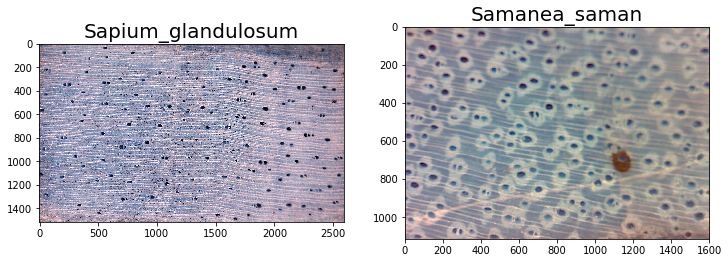

In [56]:
show_images([img_1, img_2], cols=1, titles=['Sapium_glandulosum', 'Samanea_saman'])

In [53]:
os.listdir('/notebooks/Madera_76_Especies/allDataRenamed/Samanea_saman')

['1211.jpg',
 '7325.jpg',
 '11473.jpg',
 '7334.jpg',
 '1226.jpg',
 '1214.jpg',
 '1232.jpg',
 '7316.jpg',
 '7337.jpg',
 '7313.jpg',
 '4115.jpg',
 '11471.jpg',
 '7310.jpg',
 '4103.jpg',
 '7322.jpg',
 '1217.jpg',
 '7349.jpg',
 '7343.jpg',
 '11470.jpg',
 '4106.jpg',
 '4109.jpg',
 '1223.jpg',
 '7319.jpg',
 '1220.jpg',
 '1229.jpg',
 '7340.jpg',
 '7331.jpg',
 '7298.jpg',
 '7307.jpg',
 '7301.jpg',
 '7304.jpg',
 '7328.jpg',
 '11474.jpg',
 '7346.jpg',
 '4112.jpg',
 '11472.jpg']

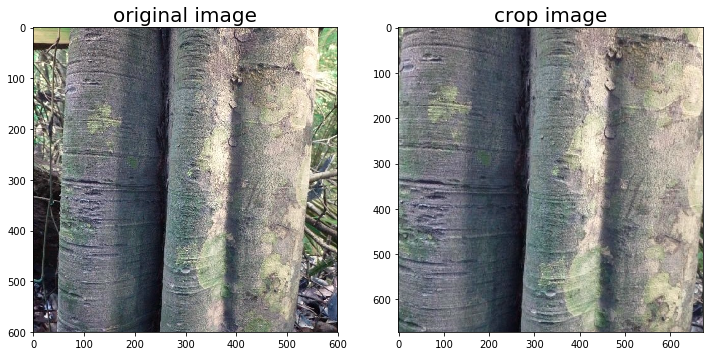

In [38]:
show_images([img_2, cut_image(img_2, 0.1, 0.1)], cols=1, titles=['original image', 'crop image'])

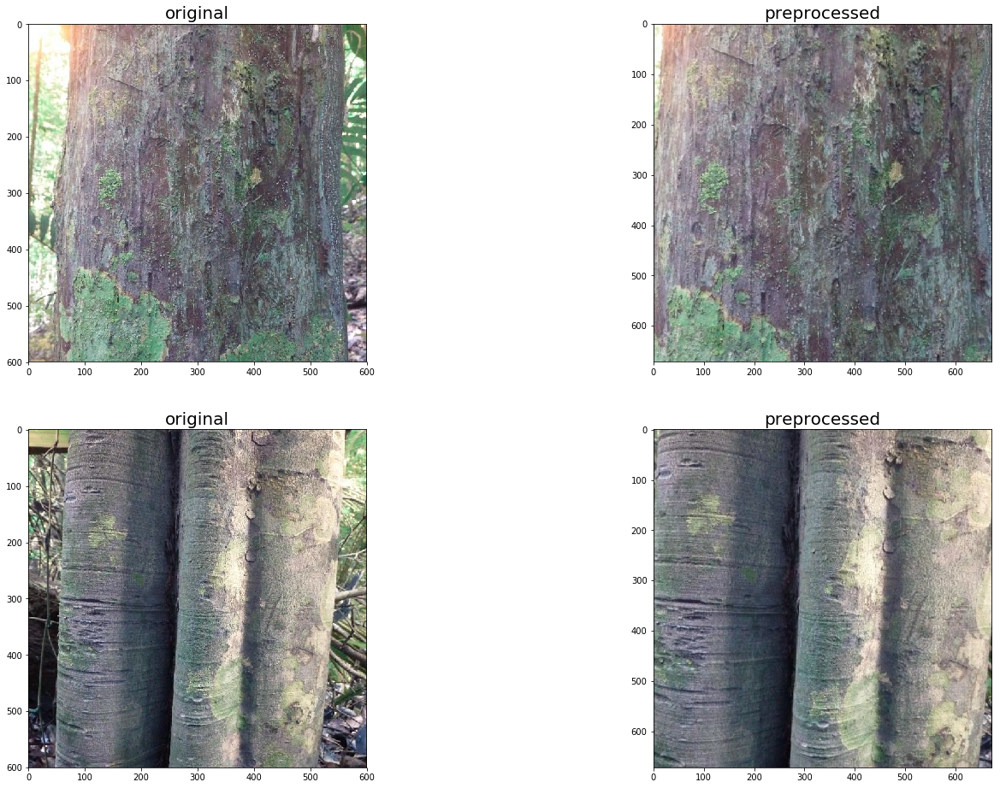

In [42]:
show_images([img, cut_image(img, 0.1, 0.1), img_2, cut_image(img_2, 0.1, 0.1)], cols=2, titles=['original', 'preprocessed', 'original', 'preprocessed'])

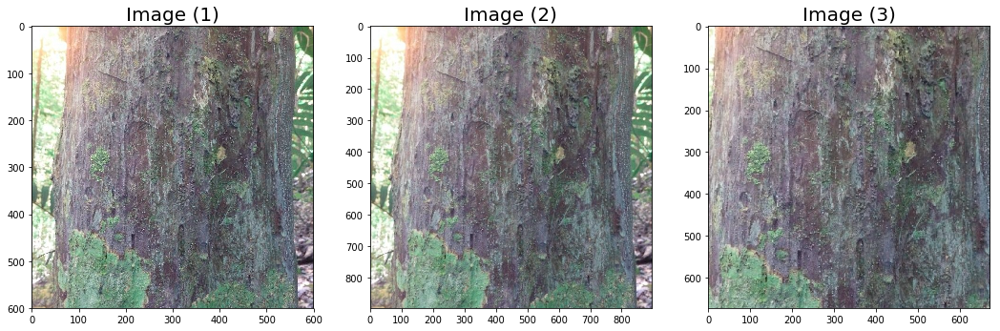

In [51]:
show_images([img, cv2.resize(img, (896, 896), interpolation=cv2.INTER_AREA), cut_image(img, 0.1, 0.1, (672,672))])

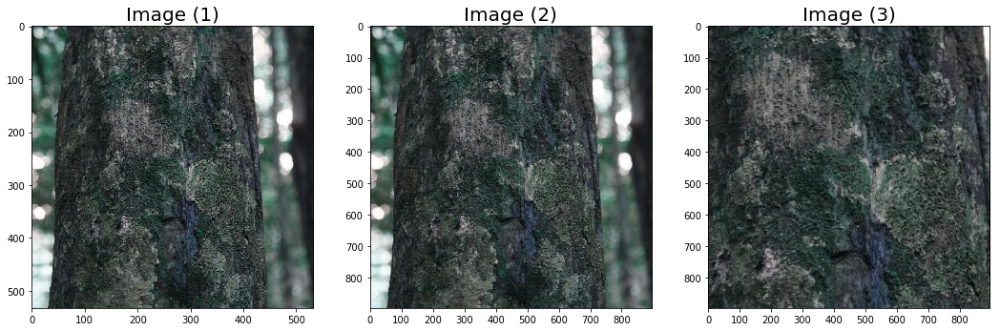

In [41]:
show_images([img, cv2.resize(img, (896, 896), interpolation=cv2.INTER_AREA), cut_image(img, 0.1, 0.2)])

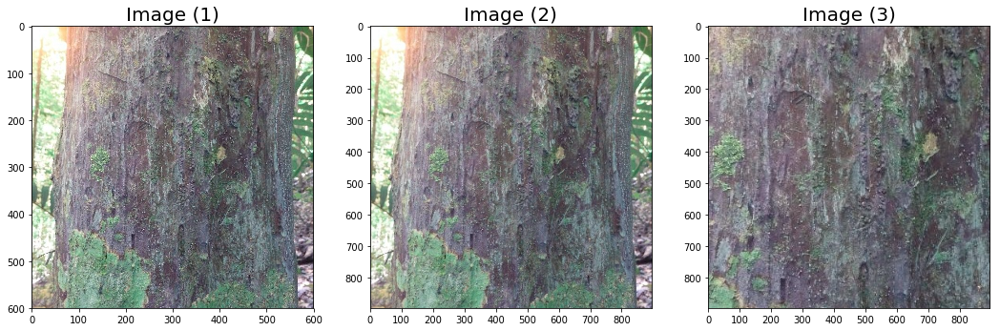

In [43]:
show_images([img, cv2.resize(img, (896, 896), interpolation=cv2.INTER_AREA), cut_image(img, 0.2, 0.2)])

In [44]:
X_bark_big, y_bark_big = image_generator_barknet[0]
X_bark_big_images = show_batch(X_bark_big, y_bark_big)

Initializing amount as a constant value: 0.58392626
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_49 (InputLayer)        (None, 224, 224, 3)       0         
_________________________________________________________________
unsharp_mask_16 (UnsharpMask (None, 224, 224, 3)       1         
Total params: 1
Trainable params: 1
Non-trainable params: 0
_________________________________________________________________
Initializing amount as a constant value: 0.58392626
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_50 (InputLayer)        (None, 224, 224, 3)       0         
_________________________________________________________________
unsharp_mask_lo_g_16 (Unshar (None, 224, 224, 3)       1         
Total params: 1
Trainable params: 1
Non-trainable params: 0
__________________________________________________

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


In [43]:
X_bark, y_bark = image_generator[0]
X_bark_images = show_batch(X_bark, y_bark)

Initializing amount as a constant value: 0.58392626
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_46 (InputLayer)        (None, 224, 224, 3)       0         
_________________________________________________________________
unsharp_mask_15 (UnsharpMask (None, 224, 224, 3)       1         
Total params: 1
Trainable params: 1
Non-trainable params: 0
_________________________________________________________________
Initializing amount as a constant value: 0.58392626
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_47 (InputLayer)        (None, 224, 224, 3)       0         
_________________________________________________________________
unsharp_mask_lo_g_15 (Unshar (None, 224, 224, 3)       1         
Total params: 1
Trainable params: 1
Non-trainable params: 0
__________________________________________________

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


In [38]:
X, y = image_generator_maderas[0]
X_images = show_batch(X, y)

Initializing amount as a constant value: -0.4
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_40 (InputLayer)        (None, 224, 224, 3)       0         
_________________________________________________________________
unsharp_mask_13 (UnsharpMask (None, 224, 224, 3)       1         
Total params: 1
Trainable params: 1
Non-trainable params: 0
_________________________________________________________________
Initializing amount as a constant value: -0.4
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_41 (InputLayer)        (None, 224, 224, 3)       0         
_________________________________________________________________
unsharp_mask_lo_g_13 (Unshar (None, 224, 224, 3)       1         
Total params: 1
Trainable params: 1
Non-trainable params: 0
______________________________________________________________

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


In [22]:
original, layer_gaussian, um_gaussian, layer_log, um_log = (X_images[i] for i in range(5)) 

## Load models trained

In [52]:
from tensorflow.keras.models import load_model 
import math

In [53]:
def get_probs_no_crops(n_images, probs_crops, idx_rows):
    probs_no_crops = []
    for i in range(n_images):
        probs_row = probs_crops[idx_rows[i]:idx_rows[i + 1]].mean(axis=0)
        probs_no_crops.append(probs_row)
    probs_no_crops = np.array(probs_no_crops)
    return probs_no_crops

def get_crops_and_labels(dataset, target_size=(224, 224)):
    out_height, out_width = target_size
    indexes = []
    crops = []
    files = dataset['files']
    labels = dataset['labels']
    crops_labels = []
    idx_rows = [0]
    for path, label in zip(files, labels):
        img = cv2.imread(path)
        (height, width) = img.shape[0], img.shape[1]
        crops_height = height//out_height
        crops_width = width//out_width
        print("Processing image in path: {}".format(path))
        idx_rows.append(idx_rows[-1] + crops_height * crops_width)
        for i in range(crops_height):
            for j in range(crops_width):
                crops.append(img[i*out_height:(i+1)*out_height, j*out_width:(j+1)*out_width, :])
                crops_labels.append(label)
    return np.array(crops), np.array(crops_labels), np.array(idx_rows)

In [54]:
def top_k_categorical(y_true, y_probs, k=5):
    predicted_labels = np.argsort(-1 * y_probs, axis=1)[:, :k]
    hits = 0
    n = y_true.shape[0]
    for i in range(n):
        if y_true[i] in predicted_labels[i]:
            hits += 1
    return hits/n

def get_accuracy_crops(experiment_path):
    model_path = os.path.join(experiment_path, 'best-model.ckpt')
    dataset_path = os.path.join(experiment_path, 'dataset_files.json')
    with open(dataset_path, 'r') as file:
        dataset = json.load(file)
    val_dataset = dataset['val']
    crops, crops_labels, idx_rows = get_crops_and_labels(val_dataset)
    model = load_model(model_path)
    model = model.layers[-2] ##Removing two last layers because they are for gpus usage.
    model.summary()
    probs_crops = model.predict(crops)
    probs_no_crops = get_probs_no_crops(len(val_dataset['labels']), probs_crops, idx_rows)
    preds_no_crops = probs_no_crops.argmax(axis=1)
    preds_crops = probs_crops.argmax(axis=1)
    acc_no_crops = accuracy_score(np.array(val_dataset['labels']), preds_no_crops)
    acc_crops = accuracy_score(crops_labels, preds_crops)
    top_acc_no_crops = top_k_categorical(np.array(val_dataset['labels']), probs_no_crops)
    top_acc_crops = top_k_categorical(crops_labels, probs_crops)
    return acc_crops, top_acc_crops, acc_no_crops, top_acc_no_crops

In [ ]:
model_path = os.path.join(experiment_path, 'best-model.ckpt')
dataset_path = os.path.join(experiment_path, 'dataset_files.json')
with open(dataset_path, 'r') as file:
    dataset = json.load(file)
val_dataset = dataset['val']

In [55]:
get_accuracy_crops('/notebooks/experiments_maderas/grid_22-06-2020_22:21:56/c847cddc-b4d6-11ea-9430-0242ac110002-22-06-2020_22:21:56')

Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Apeiba_membranacea/17967.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Apeiba_membranacea/17969.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Apeiba_membranacea/17966.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Apeiba_membranacea/17965.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Apeiba_membranacea/17968.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Apeiba_membranacea/17970.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Astronium_graveolens/10165.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Astronium_graveolens/10170.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Astronium_graveolens/10167.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Astronium_graveolens/10

Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Carapa_guianensis/11247.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Caryocar_costaricense/10810.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Caryocar_costaricense/10812.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Caryocar_costaricense/10811.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Caryocar_costaricense/10813.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Caryocar_costaricense/10814.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Caryocar_costaricense/4121.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Caryocar_costaricense/4124.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Caryocar_costaricense/4118.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Caryocar_

Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Diphysa_americana/5053.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Diphysa_americana/5041.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Drypetes_brownii/18900.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Drypetes_brownii/18896.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Drypetes_brownii/18897.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Drypetes_brownii/18895.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Drypetes_brownii/18898.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Drypetes_brownii/18899.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Enterolobium_cyclocarpum/809.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Enterolobium_cyclocarpum/815.jpg
Processi

Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Lacmellea_panamesis/8072.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Lacmellea_panamesis/7754.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Lacmellea_panamesis/7757.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Lacmellea_panamesis/8078.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Lacmellea_panamesis/7760.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Lacmellea_panamesis/8075.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Lacmellea_panamesis/8081.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Lonchocarpus_macrophyllum/15050.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Lonchocarpus_macrophyllum/15047.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Lonchocarpus_ma

Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Pentaclethra_macroloba/12448.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Pentaclethra_macroloba/12445.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Pochota_fendleri/12247.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Pochota_fendleri/12251.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Pochota_fendleri/12249.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Pochota_fendleri/12250.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Pochota_fendleri/12248.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Pochota_fendleri/12252.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Poulsenia_armata/8666.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Poulsenia_armata/8669.jpg
Processing

Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Schizolobium_parahyba/10415.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Schizolobium_parahyba/10414.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Schizolobium_parahyba/1961.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Schizolobium_parahyba/1955.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Schizolobium_parahyba/1964.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Schizolobium_parahyba/1958.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Simarouba_amara/17601.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Simarouba_amara/17599.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Simarouba_amara/17600.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Simarouba_amara/17602.jp

Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Trichilia_pleeana/2372.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Trichilia_pleeana/2366.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Trichilia_pleeana/2369.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Trichilia_pleeana/2363.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Trichilia_pleeana/2360.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Trichospermum_galeottii/19476.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Trichospermum_galeottii/19474.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Trichospermum_galeottii/19475.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Trichospermum_galeottii/19479.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Trichospermum_galeo

Trainable flag: True
This is batch normalization an executing in Tensor("conv1_bn/keras_learning_phase:0", shape=(), dtype=bool) mode
Trainable flag: True
This is batch normalization an executing in Tensor("conv1_bn/keras_learning_phase:0", shape=(), dtype=bool) mode
Trainable flag: True
This is batch normalization an executing in Tensor("conv1_bn/keras_learning_phase:0", shape=(), dtype=bool) mode
Trainable flag: True
This is batch normalization an executing in Tensor("conv1_bn/keras_learning_phase:0", shape=(), dtype=bool) mode
Trainable flag: True
This is batch normalization an executing in Tensor("conv1_bn/keras_learning_phase:0", shape=(), dtype=bool) mode
Trainable flag: True
This is batch normalization an executing in Tensor("conv1_bn/keras_learning_phase:0", shape=(), dtype=bool) mode
Trainable flag: True
This is batch normalization an executing in Tensor("conv1_bn/keras_learning_phase:0", shape=(), dtype=bool) mode
Trainable flag: True
This is batch normalization an executing 

Trainable flag: True
This is batch normalization an executing in Tensor("conv1_bn/keras_learning_phase:0", shape=(), dtype=bool) mode
Trainable flag: True
This is batch normalization an executing in Tensor("conv1_bn/keras_learning_phase:0", shape=(), dtype=bool) mode
Trainable flag: True
This is batch normalization an executing in Tensor("conv1_bn/keras_learning_phase:0", shape=(), dtype=bool) mode
Trainable flag: True
This is batch normalization an executing in Tensor("conv1_bn/keras_learning_phase:0", shape=(), dtype=bool) mode
Trainable flag: True
This is batch normalization an executing in Tensor("conv1_bn/keras_learning_phase:0", shape=(), dtype=bool) mode
Trainable flag: True
This is batch normalization an executing in Tensor("conv1_bn/keras_learning_phase:0", shape=(), dtype=bool) mode
Trainable flag: True
This is batch normalization an executing in Tensor("conv1_bn/keras_learning_phase:0", shape=(), dtype=bool) mode
Trainable flag: True
This is batch normalization an executing 

ValueError: axes don't match array

In [120]:
get_accuracy_crops('/notebooks/experiments_maderas/grid_23-06-2020_20:14:45/d631071a-b599-11ea-ab03-0242ac110002-23-06-2020_21:38:11')

Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Apeiba_membranacea/17967.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Apeiba_membranacea/17969.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Apeiba_membranacea/17966.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Apeiba_membranacea/17965.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Apeiba_membranacea/17968.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Apeiba_membranacea/17970.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Astronium_graveolens/10165.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Astronium_graveolens/10170.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Astronium_graveolens/10167.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Astronium_graveolens/10

Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Caryocar_costaricense/10812.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Caryocar_costaricense/10811.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Caryocar_costaricense/10813.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Caryocar_costaricense/10814.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Caryocar_costaricense/4121.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Caryocar_costaricense/4124.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Caryocar_costaricense/4118.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Caryocar_costaricense/4127.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Caryocar_costaricense/4130.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Caryoca

Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Drypetes_brownii/18900.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Drypetes_brownii/18896.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Drypetes_brownii/18897.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Drypetes_brownii/18895.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Drypetes_brownii/18898.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Drypetes_brownii/18899.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Enterolobium_cyclocarpum/809.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Enterolobium_cyclocarpum/815.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Enterolobium_cyclocarpum/818.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Enterolobium_cyclocarpum/821.

Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Lacmellea_panamesis/7760.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Lacmellea_panamesis/8075.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Lacmellea_panamesis/8081.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Lonchocarpus_macrophyllum/15050.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Lonchocarpus_macrophyllum/15047.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Lonchocarpus_macrophyllum/15048.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Lonchocarpus_macrophyllum/15049.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Lonchocarpus_macrophyllum/15051.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Lonchocarpus_macrophyllum/15052.jpg
Processing image in path: /notebooks/Madera_76_Especies/al

Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Pochota_fendleri/12250.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Pochota_fendleri/12248.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Pochota_fendleri/12252.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Poulsenia_armata/8666.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Poulsenia_armata/8669.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Poulsenia_armata/8675.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Poulsenia_armata/8678.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Poulsenia_armata/8672.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Pouroma_bicolor/13571.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Pouroma_bicolor/13572.jpg
Processing image in path: /

Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Schizolobium_parahyba/1955.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Schizolobium_parahyba/1964.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Schizolobium_parahyba/1958.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Simarouba_amara/17601.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Simarouba_amara/17599.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Simarouba_amara/17600.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Simarouba_amara/17602.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Simarouba_amara/17604.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Simarouba_amara/17603.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Spondias_mombin/4052.jpg
Processing image

Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Trichilia_pleeana/2363.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Trichilia_pleeana/2360.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Trichospermum_galeottii/19476.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Trichospermum_galeottii/19474.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Trichospermum_galeottii/19475.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Trichospermum_galeottii/19479.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Trichospermum_galeottii/19480.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Trichospermum_galeottii/19477.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Trichospermum_galeottii/19478.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRename

Trainable flag: False
This is batch normalization an executing in 0 mode
Trainable flag: False
This is batch normalization an executing in 0 mode
Trainable flag: False
This is batch normalization an executing in 0 mode
Trainable flag: False
This is batch normalization an executing in 0 mode
Trainable flag: False
This is batch normalization an executing in 0 mode
Trainable flag: False
This is batch normalization an executing in 0 mode
Trainable flag: False
This is batch normalization an executing in 0 mode
Trainable flag: False
This is batch normalization an executing in 0 mode
Trainable flag: False
This is batch normalization an executing in 0 mode
Trainable flag: False
This is batch normalization an executing in 0 mode
Trainable flag: False
This is batch normalization an executing in 0 mode
Trainable flag: False
This is batch normalization an executing in 0 mode
Trainable flag: False
This is batch normalization an executing in 0 mode
Trainable flag: False
This is batch normalization a

Trainable flag: False
This is batch normalization an executing in 0 mode
Trainable flag: False
This is batch normalization an executing in 0 mode
Trainable flag: False
This is batch normalization an executing in 0 mode
Trainable flag: False
This is batch normalization an executing in 0 mode
Trainable flag: False
This is batch normalization an executing in 0 mode
Trainable flag: False
This is batch normalization an executing in 0 mode
Trainable flag: False
This is batch normalization an executing in 0 mode
Trainable flag: False
This is batch normalization an executing in 0 mode
Trainable flag: False
This is batch normalization an executing in 0 mode
Trainable flag: False
This is batch normalization an executing in 0 mode
Trainable flag: False
This is batch normalization an executing in 0 mode
Trainable flag: False
This is batch normalization an executing in 0 mode
Trainable flag: False
This is batch normalization an executing in 0 mode
Trainable flag: False
This is batch normalization a

(0.43313203653688587,
 0.7123478894182623,
 0.6147260273972602,
 0.8184931506849316)

In [109]:
get_accuracy_crops('/notebooks/experiments_maderas/grid_23-06-2020_20:14:45/70ba387e-b59f-11ea-ab03-0242ac110002-23-06-2020_22:18:18')

Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Apeiba_membranacea/17967.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Apeiba_membranacea/17969.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Apeiba_membranacea/17966.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Apeiba_membranacea/17965.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Apeiba_membranacea/17968.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Apeiba_membranacea/17970.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Astronium_graveolens/10165.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Astronium_graveolens/10170.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Astronium_graveolens/10167.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Astronium_graveolens/10

Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Caryocar_costaricense/10812.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Caryocar_costaricense/10811.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Caryocar_costaricense/10813.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Caryocar_costaricense/10814.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Caryocar_costaricense/4121.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Caryocar_costaricense/4124.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Caryocar_costaricense/4118.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Caryocar_costaricense/4127.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Caryocar_costaricense/4130.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Caryoca

Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Drypetes_brownii/18900.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Drypetes_brownii/18896.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Drypetes_brownii/18897.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Drypetes_brownii/18895.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Drypetes_brownii/18898.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Drypetes_brownii/18899.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Enterolobium_cyclocarpum/809.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Enterolobium_cyclocarpum/815.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Enterolobium_cyclocarpum/818.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Enterolobium_cyclocarpum/821.

Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Lacmellea_panamesis/7760.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Lacmellea_panamesis/8075.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Lacmellea_panamesis/8081.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Lonchocarpus_macrophyllum/15050.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Lonchocarpus_macrophyllum/15047.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Lonchocarpus_macrophyllum/15048.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Lonchocarpus_macrophyllum/15049.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Lonchocarpus_macrophyllum/15051.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Lonchocarpus_macrophyllum/15052.jpg
Processing image in path: /notebooks/Madera_76_Especies/al

Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Pochota_fendleri/12250.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Pochota_fendleri/12248.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Pochota_fendleri/12252.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Poulsenia_armata/8666.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Poulsenia_armata/8669.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Poulsenia_armata/8675.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Poulsenia_armata/8678.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Poulsenia_armata/8672.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Pouroma_bicolor/13571.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Pouroma_bicolor/13572.jpg
Processing image in path: /

Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Schizolobium_parahyba/1955.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Schizolobium_parahyba/1964.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Schizolobium_parahyba/1958.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Simarouba_amara/17601.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Simarouba_amara/17599.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Simarouba_amara/17600.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Simarouba_amara/17602.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Simarouba_amara/17604.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Simarouba_amara/17603.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Spondias_mombin/4052.jpg
Processing image

Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Trichilia_pleeana/2363.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Trichilia_pleeana/2360.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Trichospermum_galeottii/19476.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Trichospermum_galeottii/19474.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Trichospermum_galeottii/19475.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Trichospermum_galeottii/19479.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Trichospermum_galeottii/19480.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Trichospermum_galeottii/19477.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Trichospermum_galeottii/19478.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRename

Trainable flag: False
This is batch normalization an executing in 0 mode
Trainable flag: False
This is batch normalization an executing in 0 mode
Trainable flag: False
This is batch normalization an executing in 0 mode
Trainable flag: False
This is batch normalization an executing in 0 mode
Trainable flag: False
This is batch normalization an executing in 0 mode
Trainable flag: False
This is batch normalization an executing in 0 mode
Trainable flag: False
This is batch normalization an executing in 0 mode
Trainable flag: False
This is batch normalization an executing in 0 mode
Trainable flag: False
This is batch normalization an executing in 0 mode
Trainable flag: False
This is batch normalization an executing in 0 mode
Trainable flag: False
This is batch normalization an executing in 0 mode
Trainable flag: True
This is batch normalization an executing in Tensor("dropout_2/keras_learning_phase:0", shape=(), dtype=bool) mode
Trainable flag: False
This is batch normalization an executing

(0.3916487118016569,
 0.6710466421873578,
 0.5856164383561644,
 0.8013698630136986)

In [110]:
get_accuracy_crops('/notebooks/experiments_maderas/grid_24-06-2020_00:37:52/f04d7fa2-b5b2-11ea-97bb-0242ac110002-24-06-2020_00:37:52')

Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Apeiba_membranacea/17967.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Apeiba_membranacea/17969.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Apeiba_membranacea/17966.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Apeiba_membranacea/17965.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Apeiba_membranacea/17968.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Apeiba_membranacea/17970.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Astronium_graveolens/10165.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Astronium_graveolens/10170.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Astronium_graveolens/10167.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Astronium_graveolens/10

Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Caryocar_costaricense/10812.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Caryocar_costaricense/10811.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Caryocar_costaricense/10813.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Caryocar_costaricense/10814.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Caryocar_costaricense/4121.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Caryocar_costaricense/4124.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Caryocar_costaricense/4118.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Caryocar_costaricense/4127.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Caryocar_costaricense/4130.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Caryoca

Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Drypetes_brownii/18900.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Drypetes_brownii/18896.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Drypetes_brownii/18897.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Drypetes_brownii/18895.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Drypetes_brownii/18898.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Drypetes_brownii/18899.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Enterolobium_cyclocarpum/809.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Enterolobium_cyclocarpum/815.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Enterolobium_cyclocarpum/818.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Enterolobium_cyclocarpum/821.

Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Lacmellea_panamesis/8078.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Lacmellea_panamesis/7760.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Lacmellea_panamesis/8075.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Lacmellea_panamesis/8081.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Lonchocarpus_macrophyllum/15050.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Lonchocarpus_macrophyllum/15047.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Lonchocarpus_macrophyllum/15048.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Lonchocarpus_macrophyllum/15049.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Lonchocarpus_macrophyllum/15051.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRe

Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Pentaclethra_macroloba/12448.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Pentaclethra_macroloba/12445.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Pochota_fendleri/12247.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Pochota_fendleri/12251.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Pochota_fendleri/12249.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Pochota_fendleri/12250.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Pochota_fendleri/12248.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Pochota_fendleri/12252.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Poulsenia_armata/8666.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Poulsenia_armata/8669.jpg
Processing

Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Schizolobium_parahyba/10415.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Schizolobium_parahyba/10414.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Schizolobium_parahyba/1961.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Schizolobium_parahyba/1955.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Schizolobium_parahyba/1964.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Schizolobium_parahyba/1958.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Simarouba_amara/17601.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Simarouba_amara/17599.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Simarouba_amara/17600.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Simarouba_amara/17602.jp

Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Trichilia_pleeana/2366.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Trichilia_pleeana/2369.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Trichilia_pleeana/2363.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Trichilia_pleeana/2360.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Trichospermum_galeottii/19476.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Trichospermum_galeottii/19474.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Trichospermum_galeottii/19475.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Trichospermum_galeottii/19479.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Trichospermum_galeottii/19480.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Trichospermu

Trainable flag: False
This is batch normalization an executing in 0 mode
Trainable flag: False
This is batch normalization an executing in 0 mode
Trainable flag: False
This is batch normalization an executing in 0 mode
Trainable flag: False
This is batch normalization an executing in 0 mode
Trainable flag: False
This is batch normalization an executing in 0 mode
Trainable flag: False
This is batch normalization an executing in 0 mode
Trainable flag: False
This is batch normalization an executing in 0 mode
Trainable flag: False
This is batch normalization an executing in 0 mode
Trainable flag: False
This is batch normalization an executing in 0 mode
Trainable flag: False
This is batch normalization an executing in 0 mode
Trainable flag: False
This is batch normalization an executing in 0 mode
Trainable flag: False
This is batch normalization an executing in 0 mode
Trainable flag: False
This is batch normalization an executing in 0 mode
Trainable flag: False
This is batch normalization a

(0.36345704488210484,
 0.6257396898613177,
 0.5565068493150684,
 0.7602739726027398)

In [111]:
get_accuracy_crops('/notebooks/experiments_maderas/grid_24-06-2020_02:47:56/c9528a34-b5d8-11ea-a86d-0242ac110002-24-06-2020_05:08:48')

Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Apeiba_membranacea/17967.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Apeiba_membranacea/17969.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Apeiba_membranacea/17966.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Apeiba_membranacea/17965.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Apeiba_membranacea/17968.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Apeiba_membranacea/17970.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Astronium_graveolens/10165.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Astronium_graveolens/10170.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Astronium_graveolens/10167.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Astronium_graveolens/10

Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Caryocar_costaricense/10812.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Caryocar_costaricense/10811.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Caryocar_costaricense/10813.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Caryocar_costaricense/10814.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Caryocar_costaricense/4121.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Caryocar_costaricense/4124.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Caryocar_costaricense/4118.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Caryocar_costaricense/4127.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Caryocar_costaricense/4130.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Caryoca

Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Drypetes_brownii/18900.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Drypetes_brownii/18896.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Drypetes_brownii/18897.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Drypetes_brownii/18895.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Drypetes_brownii/18898.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Drypetes_brownii/18899.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Enterolobium_cyclocarpum/809.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Enterolobium_cyclocarpum/815.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Enterolobium_cyclocarpum/818.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Enterolobium_cyclocarpum/821.

Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Lacmellea_panamesis/8078.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Lacmellea_panamesis/7760.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Lacmellea_panamesis/8075.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Lacmellea_panamesis/8081.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Lonchocarpus_macrophyllum/15050.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Lonchocarpus_macrophyllum/15047.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Lonchocarpus_macrophyllum/15048.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Lonchocarpus_macrophyllum/15049.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Lonchocarpus_macrophyllum/15051.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRe

Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Pentaclethra_macroloba/12448.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Pentaclethra_macroloba/12445.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Pochota_fendleri/12247.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Pochota_fendleri/12251.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Pochota_fendleri/12249.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Pochota_fendleri/12250.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Pochota_fendleri/12248.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Pochota_fendleri/12252.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Poulsenia_armata/8666.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Poulsenia_armata/8669.jpg
Processing

Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Schizolobium_parahyba/10415.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Schizolobium_parahyba/10414.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Schizolobium_parahyba/1961.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Schizolobium_parahyba/1955.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Schizolobium_parahyba/1964.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Schizolobium_parahyba/1958.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Simarouba_amara/17601.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Simarouba_amara/17599.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Simarouba_amara/17600.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Simarouba_amara/17602.jp

Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Trichilia_pleeana/2366.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Trichilia_pleeana/2369.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Trichilia_pleeana/2363.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Trichilia_pleeana/2360.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Trichospermum_galeottii/19476.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Trichospermum_galeottii/19474.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Trichospermum_galeottii/19475.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Trichospermum_galeottii/19479.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Trichospermum_galeottii/19480.jpg
Processing image in path: /notebooks/Madera_76_Especies/allDataRenamed/Trichospermu

Trainable flag: False
This is batch normalization an executing in 0 mode
Trainable flag: False
This is batch normalization an executing in 0 mode
Trainable flag: False
This is batch normalization an executing in 0 mode
Trainable flag: False
This is batch normalization an executing in 0 mode
Trainable flag: False
This is batch normalization an executing in 0 mode
Trainable flag: False
This is batch normalization an executing in 0 mode
Trainable flag: False
This is batch normalization an executing in 0 mode
Trainable flag: False
This is batch normalization an executing in 0 mode
Trainable flag: False
This is batch normalization an executing in 0 mode
Trainable flag: False
This is batch normalization an executing in 0 mode
Trainable flag: False
This is batch normalization an executing in 0 mode
Trainable flag: False
This is batch normalization an executing in 0 mode
Trainable flag: False
This is batch normalization an executing in 0 mode
Trainable flag: False
This is batch normalization a

(0.3351136467089491, 0.6036779655873517, 0.511986301369863, 0.7397260273972602)

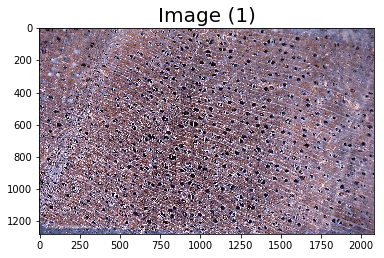

In [181]:
show_images([img])

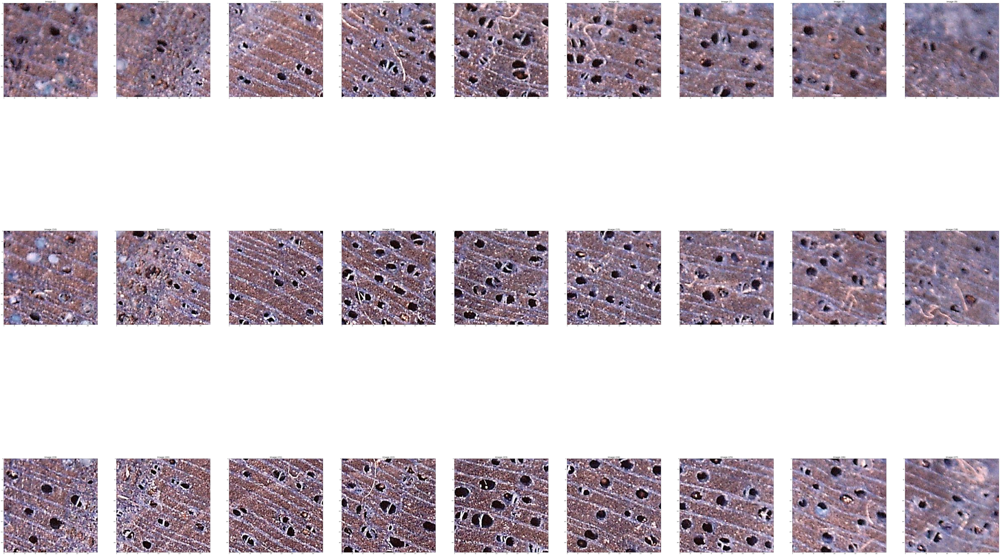

In [184]:
show_images(crops, cols=3)

In [81]:
def calculate_steps(dataset_size, batch_size):
    return math.ceil(dataset_size / batch_size)

In [97]:
probs_crops = model.predict(crops)

In [83]:
probs_crops.shape

(32953, 76)

In [98]:
probs_no_crops = get_probs_no_crops(len(val_dataset['labels']), probs_crops, idx_rows)
probs_no_crops.shape

(584, 76)

In [90]:
preds_no_crops = probs_no_crops.argmax(axis=1)
accuracy_score(np.array(val_dataset['labels']), preds_no_crops)

0.5856164383561644

In [91]:
preds_crops = probs_crops.argmax(axis=1)
accuracy_score(crops_labels, preds_crops)

0.3916487118016569

In [82]:
probs = model.predict_generator(test_image_generator_maderas, steps=calculate_steps(len(test_image_generator_maderas), 32), use_multiprocessing=False)

In [83]:
y_true = np.array(test_data_maderas['labels'])

In [59]:
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import log_loss
from sklearn.metrics import precision_recall_fscore_support
from collections import OrderedDict
import re